# Lending Club Case Study

In [1]:
#Loading the required libraries
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
import warnings
warnings.filterwarnings('once')
%matplotlib inline

In [2]:
#Loading the data
loan_df = pd.read_csv("loan.csv")
loan_df.info(verbose=True, null_counts=True)

c:\users\u21a19\appdata\local\programs\python\python36\lib\site-packages\IPython\core\interactiveshell.py:3049: DtypeWarning:

Columns (47) have mixed types. Specify dtype option on import or set low_memory=False.



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 111 columns):
id                                39717 non-null int64
member_id                         39717 non-null int64
loan_amnt                         39717 non-null int64
funded_amnt                       39717 non-null int64
funded_amnt_inv                   39717 non-null float64
term                              39717 non-null object
int_rate                          39717 non-null object
installment                       39717 non-null float64
grade                             39717 non-null object
sub_grade                         39717 non-null object
emp_title                         37258 non-null object
emp_length                        38642 non-null object
home_ownership                    39717 non-null object
annual_inc                        39717 non-null float64
verification_status               39717 non-null object
issue_d                           39717 non-null ob

Lets have a quick glance over the dataset

In [3]:
#Glance of the dataset
display(loan_df.head(5))

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


## Data preprocessing

As the objective is to identify the applicants who are likely to default. We will be using the records of applicants whose loan is approved and the applicant has either charged off or fully paid the loan amount. Lets get rid of the records which have current as their loan_status.

In [4]:
loan_df = loan_df[~(loan_df['loan_status']=='Current')]
loan_df.shape

(38577, 111)

### Dealing with missing values

In [5]:
#Lets first calculate the proportion of missing values across columns
percent_missing = loan_df.isnull().sum() * 100 / len(loan_df)
missing_value_df = pd.DataFrame({'column_name': loan_df.columns,'percent_missing': percent_missing}).sort_values('percent_missing',ascending=False)
#Only display columns having missing values
display(missing_value_df[missing_value_df.percent_missing>0])

,column_name,percent_missing
verification_status_joint,verification_status_joint,100.000000
annual_inc_joint,annual_inc_joint,100.000000
mo_sin_old_rev_tl_op,mo_sin_old_rev_tl_op,100.000000
mo_sin_old_il_acct,mo_sin_old_il_acct,100.000000
bc_util,bc_util,100.000000
bc_open_to_buy,bc_open_to_buy,100.000000
avg_cur_bal,avg_cur_bal,100.000000
acc_open_past_24mths,acc_open_past_24mths,100.000000
inq_last_12m,inq_last_12m,100.000000
total_cu_tl,total_cu_tl,100.000000


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x00000235DBCD69B0>]],
      dtype=object)

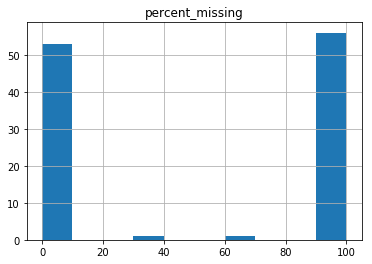

In [6]:
missing_value_df.hist(column='percent_missing',bins=10)

It seems that there are some columns which do not have information for 100% of the records. Lets dig into the number of columns having no information or all missing records.

In [7]:
len(missing_value_df[missing_value_df['percent_missing']==100])

55

There are around 55 columns out of 111 columns having 100% of missing values. We can remove them from the dataset for the further analysis.

In [8]:
#removing the columns which have 100% missing data
list_columns = list(missing_value_df[missing_value_df['percent_missing']==100]['column_name'])
loan_df_v1 = loan_df.drop(list_columns,axis=1)
loan_df_v1.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38577 entries, 0 to 39716
Data columns (total 56 columns):
id                            38577 non-null int64
member_id                     38577 non-null int64
loan_amnt                     38577 non-null int64
funded_amnt                   38577 non-null int64
funded_amnt_inv               38577 non-null float64
term                          38577 non-null object
int_rate                      38577 non-null object
installment                   38577 non-null float64
grade                         38577 non-null object
sub_grade                     38577 non-null object
emp_title                     36191 non-null object
emp_length                    37544 non-null object
home_ownership                38577 non-null object
annual_inc                    38577 non-null float64
verification_status           38577 non-null object
issue_d                       38577 non-null object
loan_status                   38577 non-null object
pymnt_pl

Now our dataset only contains 56 columns. Lets have a view of the data now.

In [9]:
loan_df_v1.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,...,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,policy_code,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens
count,3.857700e+04,3.857700e+04,38577.000000,38577.000000,38577.000000,38577.000000,3.857700e+04,38577.000000,38577.000000,38577.000000,...,38577.000000,38577.000000,38577.000000,38521.0,38577.0,38577.0,38521.0,38577.0,37880.000000,38538.0
mean,6.763787e+05,8.422843e+05,11047.025430,10784.058506,10222.481123,322.466318,6.877797e+04,13.272727,0.146668,0.871737,...,98.035545,12.772728,2746.243218,0.0,1.0,0.0,0.0,0.0,0.043479,0.0
std,2.092639e+05,2.644519e+05,7348.441646,7090.306027,7022.720644,208.639215,6.421868e+04,6.673044,0.492271,1.071546,...,698.650182,150.836853,4494.648131,0.0,0.0,0.0,0.0,0.0,0.204583,0.0
min,5.473400e+04,7.069900e+04,500.000000,500.000000,0.000000,15.690000,4.000000e+03,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,1.0,0.0,0.0,0.0,0.000000,0.0
25%,5.120330e+05,6.611310e+05,5300.000000,5200.000000,5000.000000,165.740000,4.000000e+04,8.130000,0.000000,0.000000,...,0.000000,0.000000,217.420000,0.0,1.0,0.0,0.0,0.0,0.000000,0.0
50%,6.564230e+05,8.392920e+05,9600.000000,9550.000000,8733.440000,277.860000,5.886800e+04,13.370000,0.000000,1.000000,...,0.000000,0.000000,568.260000,0.0,1.0,0.0,0.0,0.0,0.000000,0.0
75%,8.291460e+05,1.037336e+06,15000.000000,15000.000000,14000.000000,425.550000,8.200000e+04,18.560000,0.000000,1.000000,...,0.000000,0.000000,3447.250000,0.0,1.0,0.0,0.0,0.0,0.000000,0.0
max,1.077501e+06,1.314167e+06,35000.000000,35000.000000,35000.000000,1305.190000,6.000000e+06,29.990000,11.000000,8.000000,...,29623.350000,7002.190000,36115.200000,0.0,1.0,0.0,0.0,0.0,2.000000,0.0


It seems that there are some columns like chargeoff_within_12_mths, delinq_amnt, collections_12_mths_ex_med	etc which have only one value in the whole dataset.
We can just simply find out the columns which have a single value through out the dataset as using them won't help us in analysis as they have the same values for defaulters as well as non defaulters.

In [10]:
#Find columns that have constant value across
constant_value_columns = list(loan_df_v1.columns[loan_df_v1.nunique() <= 1])
for i in constant_value_columns:
    print(f"Column Name {i} , Unique Values {loan_df_v1[i].unique()}")
print(f"Number of columns with constant value {len(constant_value_columns)}")


Column Name pymnt_plan , Unique Values ['n']
Column Name initial_list_status , Unique Values ['f']
Column Name out_prncp , Unique Values [0.]
Column Name out_prncp_inv , Unique Values [0.]
Column Name collections_12_mths_ex_med , Unique Values [ 0. nan]
Column Name policy_code , Unique Values [1]
Column Name application_type , Unique Values ['INDIVIDUAL']
Column Name acc_now_delinq , Unique Values [0]
Column Name chargeoff_within_12_mths , Unique Values [ 0. nan]
Column Name delinq_amnt , Unique Values [0]
Column Name tax_liens , Unique Values [ 0. nan]
Number of columns with constant value 11


In total there are 11 variables which have a constant value throughout the dataset but there are also variables which have the missing values present in them. Following are such variables:

1. **collections_12_mths_ex_med** : It represents the Number of collections in 12 months excluding medical collections. On inspecting this, I found that there are around 0.14 % missing values in the column and as rest 99.86 % entries have the value "0", we can consider the missing values as "0".

2. **chargeoff_within_12_mths** : It represents the Number of charge-offs within 12 months. Here also around 0.14 % are missing and the rest values are "0". Thus we can consider the missing values as "0" in this case too.

3. **tax_liens** : This represents the number of tax liens that are imposed on the applicants for not paying the taxes on time. There are only around 0.09 % of missing values in this columns and the rest values are "0" which suggests that the remaining missing values can be filled using "0".

Thus, by using the above assumptions for dealing with the missing values in these three columns as we dont have any other external data source to impute these missing values we can now drop off these 11 columns as they have the same constant value throughout the dataset which will not be useful from the analysis point of view.



Now lets remove these variables and use the reduced df for the further analysis.

In [11]:
loan_df_v2 = loan_df_v1.drop(constant_value_columns,axis=1)
display(loan_df_v2.head(5))

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,pub_rec_bankruptcies
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,May-16,0.0
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,Sep-13,0.0
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,May-16,0.0
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,Apr-16,0.0
5,1075269,1311441,5000,5000,5000.0,36 months,7.90%,156.46,A,A4,...,5632.21,5000.00,632.21,0.00,0.00,0.00,Jan-15,161.03,Jan-16,0.0


Now we are left off with 45 columns, lets impute the missing values in this dataset.

In [12]:
print(len(loan_df_v2.columns))
print(loan_df_v2.columns)

45
Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'loan_status', 'url', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq', 'mths_since_last_record',
       'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d',
       'pub_rec_bankruptcies'],
      dtype='object')


For the further analysis, we will not use the following variable as these will not help us in the analysis given the objective :
1. emp_title
2. desc
3. funded_amnt
4. url
5. title
6. zip_code
7. total_pymnt
8. total_pymnt_inv
9. total_rec_prncp
10. total_rec_int
11. total_rec_late_fee
12. recoveries
13. collection_recovery_fee
14. last_pymnt_d
15. last_pymnt_amnt
16. mths_since_last_delinq
17. funded_amnt_inv
18. installment
19. last_credit_pull_d
20. issue_d

In [13]:
#Removing the columns which are not necessary
columns_removed = ['emp_title','desc','url','title','zip_code','total_pymnt','total_pymnt_inv','total_rec_prncp','total_rec_int','total_rec_late_fee','recoveries','collection_recovery_fee','last_pymnt_d','last_pymnt_amnt','mths_since_last_delinq','funded_amnt_inv','funded_amnt','installment','last_credit_pull_d','issue_d']

loan_df_v3 =loan_df_v2.drop(columns_removed,axis=1)

In [14]:
display(loan_df_v3.head(5))

,id,member_id,loan_amnt,term,int_rate,grade,sub_grade,emp_length,home_ownership,annual_inc,...,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies
0,1077501,1296599,5000,36 months,10.65%,B,B2,10+ years,RENT,24000.0,...,0,Jan-85,1,NaN,3,0,13648,83.70%,9,0.0
1,1077430,1314167,2500,60 months,15.27%,C,C4,< 1 year,RENT,30000.0,...,0,Apr-99,5,NaN,3,0,1687,9.40%,4,0.0
2,1077175,1313524,2400,36 months,15.96%,C,C5,10+ years,RENT,12252.0,...,0,Nov-01,2,NaN,2,0,2956,98.50%,10,0.0
3,1076863,1277178,10000,36 months,13.49%,C,C1,10+ years,RENT,49200.0,...,0,Feb-96,1,NaN,10,0,5598,21%,37,0.0
5,1075269,1311441,5000,36 months,7.90%,A,A4,3 years,RENT,36000.0,...,0,Nov-04,3,NaN,9,0,7963,28.30%,12,0.0


In [15]:
loan_df_v3.columns

Index(['id', 'member_id', 'loan_amnt', 'term', 'int_rate', 'grade',
       'sub_grade', 'emp_length', 'home_ownership', 'annual_inc',
       'verification_status', 'loan_status', 'purpose', 'addr_state', 'dti',
       'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths',
       'mths_since_last_record', 'open_acc', 'pub_rec', 'revol_bal',
       'revol_util', 'total_acc', 'pub_rec_bankruptcies'],
      dtype='object')

In [16]:
loan_df_v3.dtypes

id                          int64
member_id                   int64
loan_amnt                   int64
term                       object
int_rate                   object
grade                      object
sub_grade                  object
emp_length                 object
home_ownership             object
annual_inc                float64
verification_status        object
loan_status                object
purpose                    object
addr_state                 object
dti                       float64
delinq_2yrs                 int64
earliest_cr_line           object
inq_last_6mths              int64
mths_since_last_record    float64
open_acc                    int64
pub_rec                     int64
revol_bal                   int64
revol_util                 object
total_acc                   int64
pub_rec_bankruptcies      float64
dtype: object

In [17]:
#Function for converting a list of columns to categorical for a df
def convert_to_categorical(df,columnlist):
    for i in columnlist:
        df[i]=df[i].astype('category')
categories_columns = ['term','grade','sub_grade','emp_length','home_ownership','verification_status','loan_status'
                      ,'purpose','addr_state']

In [18]:
loan_df_v4 = loan_df_v3

In [19]:
convert_to_categorical(loan_df_v4,categories_columns)

loan_df_v4['revol_util'] = loan_df_v4['revol_util'].str.rstrip('%').astype(float)
loan_df_v4['int_rate'] = loan_df_v4['int_rate'].str.rstrip('%').astype(float)
loan_df_v4.earliest_cr_line = pd.to_datetime(loan_df_v4.earliest_cr_line,format='%b-%y')
loan_df_v4.inq_last_6mths = loan_df_v4.inq_last_6mths.astype('category')
#loan_df_v4.pub_rec_bankruptcies = loan_df_v4.pub_rec_bankruptcies.str.astype('int')
loan_df_v4.dtypes

id                                 int64
member_id                          int64
loan_amnt                          int64
term                            category
int_rate                         float64
grade                           category
sub_grade                       category
emp_length                      category
home_ownership                  category
annual_inc                       float64
verification_status             category
loan_status                     category
purpose                         category
addr_state                      category
dti                              float64
delinq_2yrs                        int64
earliest_cr_line          datetime64[ns]
inq_last_6mths                  category
mths_since_last_record           float64
open_acc                           int64
pub_rec                            int64
revol_bal                          int64
revol_util                       float64
total_acc                          int64
pub_rec_bankrupt

In [20]:
display(loan_df_v4.head(5))

,id,member_id,loan_amnt,term,int_rate,grade,sub_grade,emp_length,home_ownership,annual_inc,...,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies
0,1077501,1296599,5000,36 months,10.65,B,B2,10+ years,RENT,24000.0,...,0,1985-01-01,1,NaN,3,0,13648,83.7,9,0.0
1,1077430,1314167,2500,60 months,15.27,C,C4,< 1 year,RENT,30000.0,...,0,1999-04-01,5,NaN,3,0,1687,9.4,4,0.0
2,1077175,1313524,2400,36 months,15.96,C,C5,10+ years,RENT,12252.0,...,0,2001-11-01,2,NaN,2,0,2956,98.5,10,0.0
3,1076863,1277178,10000,36 months,13.49,C,C1,10+ years,RENT,49200.0,...,0,1996-02-01,1,NaN,10,0,5598,21.0,37,0.0
5,1075269,1311441,5000,36 months,7.90,A,A4,3 years,RENT,36000.0,...,0,2004-11-01,3,NaN,9,0,7963,28.3,12,0.0


In [21]:
#generating columns summary and storing them into a dataframe
columns_summary = pd.DataFrame(loan_df_v4.describe())
columns_summary["metrics"] = columns_summary.index
columns_summary = columns_summary.reset_index(drop=True)
columns_summary = pd.melt(columns_summary, id_vars="metrics")
columns_summary = pd.DataFrame(columns_summary.pivot(index='variable', columns='metrics', values='value')).reset_index(drop=False)


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x00000235DCEA9358>]],
      dtype=object)

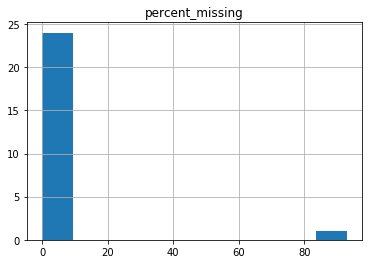

In [22]:
percent_missing = loan_df_v4.isnull().sum() * 100 / len(loan_df_v4)
missing_value_df_v1 = pd.DataFrame({'column_name': loan_df_v4.columns,'percent_missing': percent_missing}).sort_values('percent_missing',ascending=False)
missing_value_df_v1.hist(column='percent_missing',bins=10)

In [23]:
#Append some other metrics for the missing columns in missing df
missing_value_df_v2 = pd.merge(columns_summary,missing_value_df_v1,how='right',left_on='variable',right_on='column_name')

#Only display columns having missing values
display(missing_value_df_v2[missing_value_df_v2.percent_missing>0])

,variable,25%,50%,75%,count,max,mean,min,std,column_name,percent_missing
7,mths_since_last_record,19.75,90.0,104.0,2740.0,129.0,69.260949,0.0,43.987761,mths_since_last_record,92.897322
10,pub_rec_bankruptcies,0.00,0.0,0.0,37880.0,2.0,0.043479,0.0,0.204583,pub_rec_bankruptcies,1.806776
12,revol_util,25.20,49.1,72.3,38527.0,99.9,48.702777,0.0,28.364741,revol_util,0.129611
14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,emp_length,2.677761


As we can see there are almost 92.8% missing values in the mths_since_last_record column, we will remove this for the further analysis.

In [24]:
loan_df_v4 = loan_df_v4.drop('mths_since_last_record',axis=1)

## Univariate Analysis

To begin with lets have a glance of the columns that are present in the dataframe.

In [25]:
loan_df_v4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38577 entries, 0 to 39716
Data columns (total 24 columns):
id                      38577 non-null int64
member_id               38577 non-null int64
loan_amnt               38577 non-null int64
term                    38577 non-null category
int_rate                38577 non-null float64
grade                   38577 non-null category
sub_grade               38577 non-null category
emp_length              37544 non-null category
home_ownership          38577 non-null category
annual_inc              38577 non-null float64
verification_status     38577 non-null category
loan_status             38577 non-null category
purpose                 38577 non-null category
addr_state              38577 non-null category
dti                     38577 non-null float64
delinq_2yrs             38577 non-null int64
earliest_cr_line        38577 non-null datetime64[ns]
inq_last_6mths          38577 non-null category
open_acc                38577 non-nu

### loan_amt :
Loan Amount is the listed amount of the loan applied for by the borrower. Further, if at some point in time, the credit department reduces the loan amount, then it will be reflected in this value.

In [26]:
fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Box(y=loan_df_v4["loan_amnt"],name='Boxplot',marker_color='royalblue',boxmean='sd'),row=1, col=1
    
)

fig.add_trace(
    go.Histogram(x=loan_df_v4["loan_amnt"],nbinsx=7,name='Histogram',marker=dict(color='blue'),histnorm='percent'),row=1, col=2
    
)

fig['layout']['yaxis1'].update(title='Loan Amount')
fig['layout']['xaxis2'].update(title='Loan Amount')
fig['layout']['yaxis2'].update(title='Proportion')
fig.update_layout(template='plotly_white')
fig.show()

- From the boxplot, it is clear that :
    - Here the mean is 11047 where as the median is 9600 which suggests that the distribution is little bit positively skewed.
    - 50% of the Applicants out of 38577 have asked for a loan amount between 5k to 15k.
    - There are some applicants which have opted for a loan amount of greater than 30k and are appearing as outliers    in the boxplot. The only reason is that they are above the limit of Q3*1.5IQR. Though these values  are coming out as outliers but as this a loan amount data it can be possible that some people would have asked for such a loan amount and thus we will not remove them.
- The histogram in the right side suggests that :
    - If we consider the loan amount from 0k-20k, this contributes around 85% of total applicants which means that there are only 15% of the applicants who ask for loan amount of greater than 20k. Lets us find out in the further analysis, do the people who opt for loan amount above 20k are likely to default or vice-versa.

### int_rate :
It is defined as the interest Rate on the loan.

In [27]:
fig = go.Figure(go.Box(y=loan_df_v4["int_rate"],marker_color='royalblue',boxmean='sd'))
fig['layout']['yaxis'].update(title='Interest Rate')
fig.update_layout(template='plotly_white')
fig.show()

- There is no significant difference between the mean and median which suggests that the variable is almost normally distributed
- Min interest rate 5.42% and the maximum interest rate is 24.4%.
- 50% of the applicants have the interest rate between 8.94% to 14.38%.

### annual_inc :
This represents the self-reported annual income provided by the borrower during registration.

In [28]:
fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Box(y=loan_df_v4["annual_inc"],name='Boxplot',marker_color='royalblue',boxmean='sd'),row=1, col=1
    
)

fig.add_trace(
    go.Histogram(x=loan_df_v4["annual_inc"],nbinsx=15,name='Histogram',marker=dict(color='blue'),histnorm='percent'),row=1, col=2
    
)

fig['layout']['yaxis1'].update(type="log",title='Annual Income reported by Borrower')
fig['layout']['xaxis2'].update(title='Annual Income reported by Borrower')
fig['layout']['yaxis2'].update(title='Proportion')
fig.update_layout(template='plotly_white')
fig.show()

- Boxplot in the left is plotted by taking the log of yaxis values as the values are much varying it was not possible to visualize the distribution using the original axis.
    - Mean of the annual income is 68777 dollars where as the standard deviation is around 64217. This suggests that there are some applicants with a huge value of annual income which are causing such a higher standard deviation.
    - 755 of the values are between 4000 to 8200 dollars but after the third quartile there is a huge variation in the values ranging from 82k to 6 Million.
- The histogram in the right suggests that 99 % of the applicants are having the annual income below 250k where as the rest 1 % of the applicants are having annual income above 250k. Lets us find out the chances of default within these two categories of the annual income in the further analysis.

### dti :
This is ratio calculated using the borrower’s total monthly debt payments on the total debt obligations, excluding mortgage and the requested LC loan, divided by the borrower’s self-reported monthly income. <br>
**Assumption** : Variable is in the form of proportion. We got this by reading the desc provided by some of the applicants.

In [29]:
fig = go.Figure(go.Box(y=loan_df_v4["dti"],marker_color='royalblue',boxmean='sd'))
fig['layout']['yaxis'].update(title='dti')
fig.update_layout(template='plotly_white')
fig.show()

- Above boxplot suggests that the mean and median are almost same and thus it is approaching a normal distribution. Further, it can be seen that there are no outliers present in this variable.
- 25% of the applicants have the dti proportion between 0 to 8.13 whereas 50% of the applicants have dti proportion between 8.13 to 18.56.
- The third quartile i.e. the last 25% have the dti proportion between 18.56 to 29.99, let us find out the likelihood of default for these applicants in the bivariate analysis.

### open_acc and total_acc :
open_acc is the number of open credit lines in the borrower's credit file where as total_acc is the total number of credit lines currently in the borrower's credit file. <br>
Instead of using these columns as individual, we can create a new derived metric which will be the ratio of the open_acc with respect to total_acc. This new derived metric will represent the proportion of open credit files with respect to the total number of credit files for a borrower.

In [30]:
#Creating a new derived metric
loan_df_v4['open_acc_prop'] = loan_df_v4['open_acc']/loan_df_v4['total_acc']

### Derived metric : open_acc_prop

In [31]:
fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Box(y=loan_df_v4["open_acc_prop"],name='Boxplot',marker_color='royalblue',boxmean='sd'),row=1, col=1
    
)

fig.add_trace(
    go.Histogram(x=loan_df_v4["open_acc_prop"],name='Histogram',marker=dict(color='blue')),row=1, col=2
    
)

fig['layout']['yaxis1'].update(title='Proportion of open credit files w.r.t to total credit lines')
fig['layout']['xaxis2'].update(title='Proportion of open credit files w.r.t to total credit lines')
fig['layout']['yaxis2'].update(title='Count of Values')
fig.update_layout(template='plotly_white')
fig.show()

The distribution of this variable seems to be normal except : 
- The 774 outliers that represents that the applicant has the all his credit files open. This seems to be okay as it is possible that there can be persons with all open credit files and still opting for a loan. Further, we can find out the chances of being such person defaulter in the bivariate analysis later.
- The outlier having value 1.75 suggests that the total number of credit files is less than the open credit files, this can't be possible in practical world.<br>
Let us dig down into the dataset in order to know more about this particular outlier.

In [32]:
#Filter df for the outliers
display(loan_df_v4[loan_df_v4.open_acc_prop>1])

,id,member_id,loan_amnt,term,int_rate,grade,sub_grade,emp_length,home_ownership,annual_inc,...,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies,open_acc_prop
39642,127213,85483,2000,36 months,7.12,A,A1,10+ years,MORTGAGE,118000.0,...,0,1991-06-01,0,14,0,4709,18.5,8,NaN,1.75


For this analysis, we can consider this value as outlier as it not possible for someone to have total credit lines less than number of open credit lines. Thus we will remove the row corresponding to the value of open_acc_prop as 1.75.

In [33]:
#Removing the outlier
loan_df_v4=loan_df_v4[~(loan_df_v4.open_acc_prop>1)]

### pub_rec
pub_rec represents the number of derogatory public records.

In [34]:
fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Box(y=loan_df_v4["pub_rec"],name='Boxplot',marker_color='royalblue',boxmean='sd'),row=1, col=1
    
)

fig.add_trace(
    go.Histogram(x=loan_df_v4["pub_rec"],name='Histogram',marker=dict(color='blue'),histnorm='percent'),row=1, col=2
    
)

fig['layout']['yaxis1'].update(title='Number of public records')
fig['layout']['xaxis2'].update(title='Number of public records')
fig['layout']['yaxis2'].update(title='Proportion')
fig.update_layout(template='plotly_white')
fig.show()

It seems that around 94.6 % values are 0 which means we have 94.6 % of applicants having no public records againsts them and then there are rest with either 1 or greater number of public records

### pub_rec_bankruptcies
pub_rec_bankruptcies represents the number of public record bankruptcies

In [35]:
fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Box(y=loan_df_v4["pub_rec_bankruptcies"],name='Boxplot',marker_color='royalblue',boxmean='sd'),row=1, col=1
    
)

fig.add_trace(
    go.Histogram(x=loan_df_v4["pub_rec_bankruptcies"],name='Histogram',marker=dict(color='blue'),histnorm='percent'),row=1, col=2
    
)

fig['layout']['yaxis1'].update(title='Number of public record bankruptcies')
fig['layout']['xaxis2'].update(title='Number of public record bankruptcies')
fig['layout']['yaxis2'].update(title='Proportion')
fig.update_layout(template='plotly_white')
fig.show()

Above graphs suggests that around 95.6 % values are 0 which means we have 95.6 % of applicants having no public record bankruptcies againsts them and then there are rest with either 1 or greater number of public record bankruptcies

### revol_bal
This represents total credit revolving balance of the applicant.

In [36]:
fig = go.Figure(go.Box(y=loan_df_v4["revol_bal"],marker_color='royalblue',boxmean='sd'))
fig['layout']['yaxis'].update(title='Total Revolving Balance')
fig.update_layout(template='plotly_white')
fig.show()

Difference between the mean and median suggest a positive skewness in the data. Also, there are many outliers which means that there are many applicants with  more than 40k revolving balance. We will find out the chances of them defaulting the loan in the univariate analysis.

### revol_util :
revol_util represents the revolving line utilization rate, or the amount of credit the borrower is using relative to all available revolving credit.

In [37]:
fig = make_subplots(rows=1, cols=2)

fig.add_trace(
    go.Box(y=loan_df_v4["revol_util"],name='Boxplot',marker_color='royalblue',boxmean='sd'),row=1, col=1
    
)

fig.add_trace(
    go.Histogram(x=loan_df_v4["revol_util"],name='Histogram',marker=dict(color='blue'),histnorm='percent',xbins = dict(start=0,end=100,size=5)),row=1, col=2
    
)

fig['layout']['yaxis1'].update(title='Number of public record bankruptcies')
fig['layout']['xaxis2'].update(title='Number of public record bankruptcies')
fig['layout']['yaxis2'].update(title='Proportion')
fig.update_layout(template='plotly_white')
fig.show()

Revolving utilizate rate seems to have a normal distribution. Only thing to notic here is there are even applicants with 99.9 percent of utilization rate. Lets find out inn bivariate analysis, whether the persons with higher utilization rate tend to default more or not.

In [38]:
def categorical_univariate_plot(variable_name,xaxistitle,yaxistitle):
    df_data = loan_df_v4.groupby(variable_name)[['loan_amnt']].count().reset_index(drop=False)
    df_data = df_data.rename(columns={'loan_amnt':'Count'})
    df_data['Proportion'] = round(df_data['Count']/sum(df_data['Count'])*100,2)
    df_data['Proportion'] = df_data['Proportion'].astype(str) + '%'
    #print(df_data)
    fig = px.bar(df_data, x=variable_name, y='Count',template='plotly_white',text='Proportion')
    fig.update_traces(textposition='outside',textfont_size=12)
    fig.update_layout(
    xaxis_title=xaxistitle,
    yaxis_title=yaxistitle
    )

    return fig
    

### loan_status :
This represents the current status of loan. This is our dependent variable. Lets see how much of the proportion of applicant are fully paid and how much proportion is charged off.

In [39]:
loan_status = categorical_univariate_plot('loan_status',"Loan Status","Count of records")
loan_status.show()

Above graph suggests that 85% of the applicants have fully paid the loan where as the rest 15% of the applicants have charged off.

### inq_last_6mths :
This represents the number of inquiries in past 6 months (excluding auto and mortgage inquiries).

In [40]:
inq_last_6mths = categorical_univariate_plot('inq_last_6mths',"Enquiries since last 6 months","Count of records")
inq_last_6mths.show()

- Around 50% of the applicants have faced 1-3 enquiries.
- 48 % of the applicants have faced no enquiries since the last since 6 months.
- Very few applicants have faced the enquiries count greater then 3.

### term 
This represents the number of payments on the loan. Values are in months and can be either 36 or 60.

In [41]:
term = categorical_univariate_plot('term',"Term in months","Count of records")
term.show()

There are around 75% of the applicants who have opted for the 36 Months loan term where the rest 25% has opted for the 60 Months loan term.

### grade :
This represents the grade assigned by the lending club to the loan.

In [42]:
grade = categorical_univariate_plot('grade','Grade','Count of records')
grade.show()

- 76% of the loan applicants have been assigned the grade A, B or C. Further, Grade B has been assigned to 30% of the applicants.

### sub_grade :
This represents the sub grade assigned by the lending club to the loan.

In [43]:
sub_grade = categorical_univariate_plot('sub_grade','Sub Grades','Count of records')
sub_grade.show()

- Across the most frequent grade B, we have the B3 which is assigned to almost 7.3 % of the records.

### home_ownership :
This represents home ownership status provided by the borrower during registration. Our values are: RENT, OWN, MORTGAGE, OTHER where Rent means the applicant has a rented house, Own means the applicant has its own house, Mortgage means the house of applicant is mortgaged for some purpose and Other means any other scenarios.

In [44]:
home_ownership = categorical_univariate_plot('home_ownership','Home ownership status','Count of records')
home_ownership.show()

We can see that 92% of the applicants have either their home ownership as Rent or as Mortgage.

### emp_length :
This represents the employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years.

In [45]:
emp_length = categorical_univariate_plot('emp_length',"Employment Length",'Count of records')
emp_length.show()

22% of the applicants have 10+ years of employment length where as 12% have the <1 year of employment length.

### verification_status :
This indicates indicates if income was verified by LC, not verified, or if the income source was verified

In [46]:
verification_status = categorical_univariate_plot('verification_status',"Verification Status",'Count of records')
verification_status.show()

- Around 43% of the applicants are not verified.

### purpose :
This represents the category provided by the borrower for the loan request. 

In [47]:
purpose = categorical_univariate_plot('purpose',"Purpose stated by Applicant","Count of records")
purpose.show()

Seems that 47% of applicants have opted for the loan for debt conslidation.

### addr_state :
It represents the state provided by the borrower in the loan application.

In [48]:
addr_state = categorical_univariate_plot('addr_state',"State","Count of records")
addr_state.show()

Highest number of applicants are from CA followed by NY followed by TX.

## Segmented Univariate Analysis

In segmented univariate, we will analyze the segments of a variable and how those segments have a effect on the outcome variable i.e. loan_status

In [49]:
def segments_plot(variable_name,xaxistitle,yaxistitle):
    tmp_df = loan_df_v4.groupby([variable_name,'loan_status']).agg({'id':'count'})
    tmp_df = tmp_df.groupby(level=0).apply(lambda x: 100 * x / float(x.sum()))
    tmp_df =tmp_df.reset_index(drop=False).rename(columns={'id':'Proportion'})
    fig = go.Figure(data=[
        go.Bar(name='Charged Off', x=tmp_df[tmp_df.loan_status=="Charged Off"][variable_name], y=tmp_df[tmp_df.loan_status=="Charged Off"]['Proportion'],marker=dict(color='red')),
        go.Bar(name='Fully Paid', x=tmp_df[tmp_df.loan_status=="Fully Paid"][variable_name], y=tmp_df[tmp_df.loan_status=="Fully Paid"]['Proportion'],marker=dict(color='lightsteelblue'))
    ])
    # Change the bar mode
    fig.update_layout(barmode='stack',xaxis_title=xaxistitle,yaxis_title=yaxistitle,template='plotly_white')
    return fig

In [50]:
#variable_name ='purpose'
def default_avg(variable_name):
    tmp_df = loan_df_v4.groupby([variable_name,'loan_status']).agg({'id':'count'})
    tmp_df = tmp_df.groupby(level=0).apply(lambda x: 100 * x / float(x.sum()))
    tmp_df =tmp_df.reset_index(drop=False).rename(columns={'id':'Proportion'})
    highest = tmp_df[tmp_df.loan_status=='Charged Off'].sort_values('Proportion',ascending=False)[variable_name].iloc[0]
    tmp_v1 = tmp_df[(tmp_df[variable_name]!=highest)&(tmp_df.loan_status=="Charged Off")]['Proportion']
    highest_prop = tmp_df[(tmp_df[variable_name]==highest)&(tmp_df.loan_status=="Charged Off")]['Proportion'].iloc[0]
    tmp_v1 = highest_prop - tmp_v1
    return np.mean(tmp_v1)

### purpose :

In [51]:
segments_plot('purpose',"Purpose of Loan","Proportion").show()
print(round(default_avg('purpose'),1))

13.0


The person opting for the loan and state purpose as small business tend to default 27% of the times.<br>
On average there are 13% more chance of the applicant being defaulter if the purpose is stated as small business as compared to other purposes.

### home_ownership

In [52]:
segments_plot('home_ownership',"Home Ownership Status","Proportion").show()
print(round(default_avg('home_ownership'),1))

3.7


People who state their ownership as Other tend to default 18.3 % of times but this increases the chances of default by 3.7 %. Though, we can see that there is no signifcant difference across the four home ownership status which are there, the higher value of 3.7% might be due to the records of None, in which all the loans are fully paid.

### grade

In [53]:
segments_plot('grade',"Grade","Proportion").show()
print(round(default_avg('grade'),1))

14.3


### addr_state :

In [54]:
segments_plot('addr_state',"Address State","Proportion").show()
print(round(default_avg('addr_state'),1))

46.0


Applicants who belong state NE have been charged off 60% of the times. Further, the chances of being charged off increases by 46% if the person belongs to state NE.

### verification_status :

In [55]:
segments_plot('verification_status',"Verification Status","Proportion").show()
print(round(default_avg('verification_status'),1))

3.0


There is no signifant difference in the chances of being charged off based on the verification status.

### term

In [56]:
segments_plot('term',"Term","Proportion").show()
print(round(default_avg('term'),1))

14.2


Above graph suggests that people who opt for a term of 60 months tend to default 25% of the times. Also, it means that the chances of being charged off increases by 14.2% when a applicant goes for a term duration from 36 months to 60 months.

### emp_length

In [57]:
segments_plot('emp_length',"Employment Length","Proportion").show()
print(round(default_avg('emp_length'),1))

1.6


There is no much difference between the employment length and thus it showing not much significant effect on the chances of being charged off for a applicant.

### inq_last_6mths

In [58]:
segments_plot('inq_last_6mths',"Enquiries since last 6 months","Proportion").show()
print(round(default_avg('inq_last_6mths'),1))

10.9


It seems that applicants who had no enquiries in the last 6 Months tend have very less chances of default. Also, we can see a that the chances of being charged off are increasing as the number of enquiries is increasing. Though the increase is not that huge but still it is following a positive trend.

In [59]:
def segments_boxplot(variable_name,xaxistitle,yaxistitle,log_y=False):
    fig = go.Figure()
    fig.add_trace(
        go.Box(y=loan_df_v4[loan_df_v4.loan_status=="Charged Off"][variable_name],name='Charged Off',marker_color='red',boxmean='sd')
    )

    fig.add_trace(
        go.Box(y=loan_df_v4[loan_df_v4.loan_status=="Fully Paid"][variable_name],name='Fully Paid',marker_color='blue',boxmean='sd')
    )
    fig.update_layout(xaxis_title=xaxistitle,yaxis_title=yaxistitle,template='plotly_white')
    if log_y:
        fig.update_layout(yaxis_type="log")
    return fig

### revol_util

In [60]:
segments_boxplot('revol_util',"Loan Status","Revolving Line Utilization Rate")

We can see that the revolving line utilization rate for the applicants who have fully paid the loan is normally distributed where as for the applicants who have been charged off the median is higher than the mean which means the distribution is negative skewed which indicates that there are more values on the right side on the mean. <br>
There is clearly a significant difference across the distribution for the revolving line utilization rate for those who are charged off and who fully paid the loan. Thus, this variable can be a driver for identifying the default.

### pub_rec :

In [61]:
segments_boxplot('pub_rec',"Loan Status","Number of public records")

There isn't any significant differences between those who are charged off and those who have fully paid the loan based on the number of public records

### pub_rec_bankruptcies

In [62]:
segments_boxplot('pub_rec_bankruptcies',"Loan Status","Number of public record bankruptcies")


There isn't any significant differences between those who are charged off and those who have fully paid the loan based on the number of public record bankruptcies.

### annual_inc

In [63]:
segments_boxplot('annual_inc',"Loan Status","Annual Income of the Applicant",log_y=True)


- Even the applicants having 1.25M annual income are charged off.
- Applicants who have salary above 1.25M didn't default on the loan.
- The applicants who are charged off have the median salary of 53k whereas the applicants who fully paid the loan have their median salary as 60k.

### open_acc

In [64]:
segments_boxplot('open_acc',"Loan Status","Number of open credit lines")

The number of open credit lines doesn't show any significant difference between those who are charged off and those fully paid the loan

### open_acc_prop

In [65]:
segments_boxplot('open_acc_prop',"Loan Status","Proportion of open credit line w.r.t total credit lines")

This variable is also not showing any significant difference across the two different categories of applicants.

### revol_bal :

In [66]:
segments_boxplot('revol_bal',"Loan Status","Total revolving balance")

No signifcant difference based on the total revolving balances

### dti :

In [67]:
segments_boxplot('dti',"Loan Status","Debt to Income Ratio")

- Min and Max is almost same even the fully paid applicant is having the max dti as 29.99 in the data set.
- There is a little difference in both the distributions, Charged Off applicants seem to have a little bit of negative skewness which suggests that most of the values are in the right side of the mean. Thus, the number of applicants with high dti values is slightly more in the Charged Off Applicants as compared to the Fully Paid Applicants.

### delinq_2yrs

In [68]:
segments_boxplot('delinq_2yrs',"Loan Status","Delinquecy since last 2 years")

Most of the values as 0 and also there isnt any significant difference between charged off and fully paid applicants based on the delinquecy since last 2 years.

In [69]:
loan_df_v4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38576 entries, 0 to 39716
Data columns (total 25 columns):
id                      38576 non-null int64
member_id               38576 non-null int64
loan_amnt               38576 non-null int64
term                    38576 non-null category
int_rate                38576 non-null float64
grade                   38576 non-null category
sub_grade               38576 non-null category
emp_length              37543 non-null category
home_ownership          38576 non-null category
annual_inc              38576 non-null float64
verification_status     38576 non-null category
loan_status             38576 non-null category
purpose                 38576 non-null category
addr_state              38576 non-null category
dti                     38576 non-null float64
delinq_2yrs             38576 non-null int64
earliest_cr_line        38576 non-null datetime64[ns]
inq_last_6mths          38576 non-null category
open_acc                38576 non-nu

### Bivariate Analysis

### revol_bal and revol_util

In [70]:
fig = px.scatter(x=loan_df_v4['revol_bal'], y=loan_df_v4['revol_util'])
fig.update_layout(template='plotly_white')
fig.update_xaxes(title="Revolving Balance")
fig.update_yaxes(title="Revolving utilization rate")
fig.show()

Seems that there is no correlation between the variables

In [74]:
def plot_bivariate(variable_x,variable_y,xaxistitle,yaxistitle):
    tmp_df = loan_df_v4.groupby([variable_x,variable_y,'loan_status']).agg({'id':'count'})
    tmp_df = tmp_df.groupby(level=0).apply(lambda x: 100 * x / float(x.sum()))
    tmp_df =tmp_df.reset_index(drop=False).rename(columns={'id':'Proportion'})
    tmp_df = tmp_df[tmp_df.loan_status=="Charged Off"]
    fig = px.scatter(tmp_df, x=variable_x, y=variable_y,size='Proportion', hover_data=['Proportion'])
    fig.update_layout(template='plotly_white')
    fig.update_xaxes(title=xaxistitle)
    fig.update_yaxes(title=yaxistitle)
    return fig

In [75]:
plot_bivariate('grade','term','Grade','Term')

There seems to be an pattern in the above graph, the term with 60 months duration was having more chances of default in univariate analysis and also we have seen that Grades also have a impact of the chances of being default.<br>
Together also they make a clear increasing pattern when one applicant moves from a grade from A-G in the term of 60 months.

In [76]:
plot_bivariate('grade','sub_grade','Grade','Sub Grade')

In [77]:
plot_bivariate('purpose','emp_length','Purpose','Employment Length')

In [80]:
fig = px.box(loan_df_v4, x="verification_status", y="annual_inc")
fig.update_yaxes(type="log")
fig.show()